In [1]:
import os
import sys
import json
import argparse

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import nibabel as nib

from glob import glob
from nilearn.glm.second_level import SecondLevelModel
from nilearn.glm.second_level import make_second_level_design_matrix
from nilearn.image import threshold_img
from nilearn.glm import threshold_stats_img

/bgfs/bchandrasekaran/krs228/software/miniconda3/envs/py3/lib/python3.9/site-packages/nilearn/glm/__init__.py:55: FutureWarning: The nilearn.glm module is experimental. It may change in any future release of Nilearn.
  warn('The nilearn.glm module is experimental. '


In [2]:
from nilearn import plotting, datasets, surface

# for plotting slices
mni152_template = datasets.load_mni152_template(resolution=1)
# for plotting on surface
fsaverage = datasets.fetch_surf_fsaverage('fsaverage')

In [3]:
task_label = 'tonecat'
contrast_label = 'sound'
fwhm = 0 # 4.5
space_label = 'MNI152NLin2009cAsym'

# define data directories
bidsroot = os.path.join('/bgfs/bchandrasekaran/krs228/data/', 
                        'FLT/',
                        'data_denoised',
                       )
nilearn_dir = os.path.join(bidsroot, 'derivatives', 'nilearn')

# define first-level directory where group-level inputs will be pulled from
l1_dir = os.path.join(nilearn_dir, 'level-1_fwhm-%.02f'%fwhm)

# create output directory
group_out_dir = os.path.join(nilearn_dir, 'group_fwhm-%.02f'%fwhm)
if not os.path.exists(group_out_dir):
        os.makedirs(group_out_dir)

# Second-level analyses

Based on [nilearn documentation](https://nilearn.github.io/stable/auto_examples/05_glm_second_level/plot_thresholding.html#statistical-testing-of-a-second-level-analysis)

### Build the group-level design matrix

#### Read the `participants.tsv` file from the BIDS root directory

In [4]:
participants_fpath = os.path.join(bidsroot, 'participants.tsv')
participants_df = pd.read_csv(participants_fpath, sep='\t')

# subjects to ignore (not fully processed, etc.)
ignore_subs = ['sub-FLT27',
               'sub-FLT07', # bad QA 11/14/23
               #'sub-FLT02', 'sub-FLT04', 'sub-FLT18', 'sub-FLT19',
              ]
participants_df.drop(participants_df[participants_df.participant_id.isin(ignore_subs)].index, inplace=True)

# re-sort by participant ID
participants_df.sort_values(by=['participant_id'], ignore_index=True, inplace=True)

In [5]:
print(participants_df)

   participant_id  age sex         group  FFR_id
0       sub-FLT02   21   F  non-Mandarin  1002.0
1       sub-FLT03   25   F      Mandarin  2002.0
2       sub-FLT04   21   F  non-Mandarin  1003.0
3       sub-FLT05   26   M      Mandarin  3010.0
4       sub-FLT06   21   F  non-Mandarin  3001.0
5       sub-FLT08   23   F      Mandarin  2005.0
6       sub-FLT09   30   F  non-Mandarin  3002.0
7       sub-FLT10   23   F      Mandarin  2006.0
8       sub-FLT11   20   F  non-Mandarin  1005.0
9       sub-FLT12   20   F  non-Mandarin  3004.0
10      sub-FLT13   23   F  non-Mandarin  3005.0
11      sub-FLT14   23   M  non-Mandarin  3006.0
12      sub-FLT15   22   M      Mandarin  2010.0
13      sub-FLT17   29   F      Mandarin     NaN
14      sub-FLT18   24   M      Mandarin  2016.0
15      sub-FLT19   24   M      Mandarin  2018.0
16      sub-FLT20   26   F  non-Mandarin  3008.0
17      sub-FLT21   21   M      Mandarin  2011.0
18      sub-FLT22   41   F      Mandarin  2017.0
19      sub-FLT23   

In [6]:
# create group-specific lists of subject IDs
sub_list_mand = list(participants_df.participant_id[participants_df.group=='Mandarin'])
sub_list_nman = list(participants_df.participant_id[participants_df.group=='non-Mandarin'])

In [7]:
print(sub_list_mand)

['sub-FLT03', 'sub-FLT05', 'sub-FLT08', 'sub-FLT10', 'sub-FLT15', 'sub-FLT17', 'sub-FLT18', 'sub-FLT19', 'sub-FLT21', 'sub-FLT22', 'sub-FLT23', 'sub-FLT24', 'sub-FLT26']


In [8]:
print(sub_list_nman)

['sub-FLT02', 'sub-FLT04', 'sub-FLT06', 'sub-FLT09', 'sub-FLT11', 'sub-FLT12', 'sub-FLT13', 'sub-FLT14', 'sub-FLT20', 'sub-FLT25', 'sub-FLT28', 'sub-FLT30']


#### Create design matrixes

In [9]:
# get participant IDs and their group labels
subjects_label = list(participants_df.participant_id)
groups_label = list(participants_df.group)

# make new dataframe from the group labels
design_mat_groupdiff = pd.DataFrame({'Mand': groups_label,
                                     'NMan': groups_label,
                                    }
                                   )
# convert to 1s and 0s for each group as appropriate
design_mat_groupdiff['Mand'].loc[design_mat_groupdiff['Mand'] == 'Mandarin'] = 1
design_mat_groupdiff['Mand'].loc[design_mat_groupdiff['Mand'] == 'non-Mandarin'] = 0
design_mat_groupdiff['NMan'].loc[design_mat_groupdiff['NMan'] == 'Mandarin'] = 0
design_mat_groupdiff['NMan'].loc[design_mat_groupdiff['NMan'] == 'non-Mandarin'] = 1
design_mat_groupdiff = design_mat_groupdiff.astype('int')
print(design_mat_groupdiff)

    Mand  NMan
0      0     1
1      1     0
2      0     1
3      1     0
4      0     1
5      1     0
6      0     1
7      1     0
8      0     1
9      0     1
10     0     1
11     0     1
12     1     0
13     1     0
14     1     0
15     1     0
16     0     1
17     1     0
18     1     0
19     1     0
20     1     0
21     0     1
22     1     0
23     0     1
24     0     1


### Get files

In [10]:
# get the beta map for the contrast of interest for each subject

#l1_fnames_groupdiff = [sorted(glob(l1_dir+'/%s_space-%s/run-all/*%s_map-beta.nii.gz'%(sub_id, space_label, contrast_label)))[0] for sub_id in subjects_label]
l1_fnames_groupdiff = [sorted(glob(l1_dir+f'/{sub_id}_space-{space_label}/run-all_LSS/*contrast-{contrast_label}_model-LSS_map-beta.nii.gz'))[0] for sub_id in subjects_label]

In [11]:
len(l1_fnames_groupdiff)

25

### Mandarin-speaking group:

#### Using combined GLM, with contrast isolating Mandarin group

In [33]:
# create a model object
second_level_model = SecondLevelModel(smoothing_fwhm=3).fit(l1_fnames_groupdiff, design_matrix=design_mat_groupdiff)

# fit the model with our contrast of interest
z_map = second_level_model.compute_contrast(second_level_contrast=[1, 0,], output_type='z_score')

In [34]:
# threshold the second-level stats image
alpha = 0.05
cthresh = 10
cluster_correct = None # 'fdr'

thresholded_map, zthresh = threshold_stats_img(
                            z_map,
                            alpha=alpha,
                            height_control=cluster_correct,
                            cluster_threshold=cthresh,
                            two_sided=True,
                        )

In [21]:
'''
z_fpath   = os.path.join(group_out_dir,
                         'group-Mand_space-{}_contrast-{}_LSS_map-zstat.nii.gz'.format(space_label, contrast_label))
thr_fpath = os.path.join(group_out_dir,
                         'group-Mand_space-{}_contrast-{}_LSS_alpha-{}_correct-{}_cthresh-{}_map-zstat.nii.gz'.format(space_label, contrast_label, 
                                                                                                                  alpha, cluster_correct, cthresh))

nib.save(z_map, z_fpath)
nib.save(thresholded_map, thr_fpath)
'''

In [35]:
plot_title = ('Mandarin-speaking group (n=%d)\n'
              '%s > baseline FDR-corrected z map \n'
              'p < %.02f, clusters > %d voxels'%(len(sub_list_mand), contrast_label, alpha, cthresh))

The None=0.05 threshold is 3


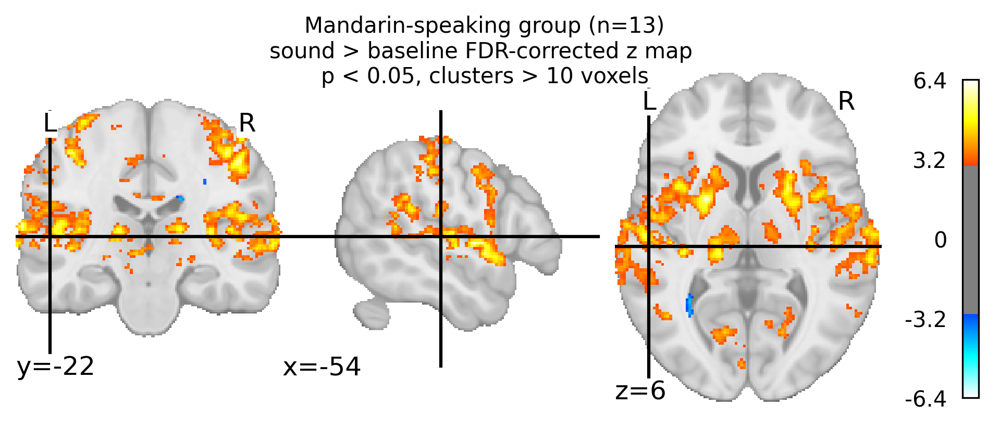

In [36]:
fig, ax = plt.subplots(figsize=(8,3), dpi=300)

plotting.plot_stat_map(
    thresholded_map, 
    threshold=zthresh,
    bg_img=mni152_template,
    black_bg=False,
    cut_coords=[-54, -22, 6],
    #display_mode='mosaic',
    #title=plot_title,
    axes=ax)
fig.suptitle(plot_title, fontsize=10);
print('The %s=%.3g threshold is %.3g' %(cluster_correct, alpha, zthresh))
#fig.savefig(os.path.join(group_out_dir,
#                     'group-Mand_space-{}_contrast-{}_view-ortho.png'.format(space_label, contrast_label)))

Interactive viewer:

/bgfs/bchandrasekaran/krs228/software/miniconda3/envs/py3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:758: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



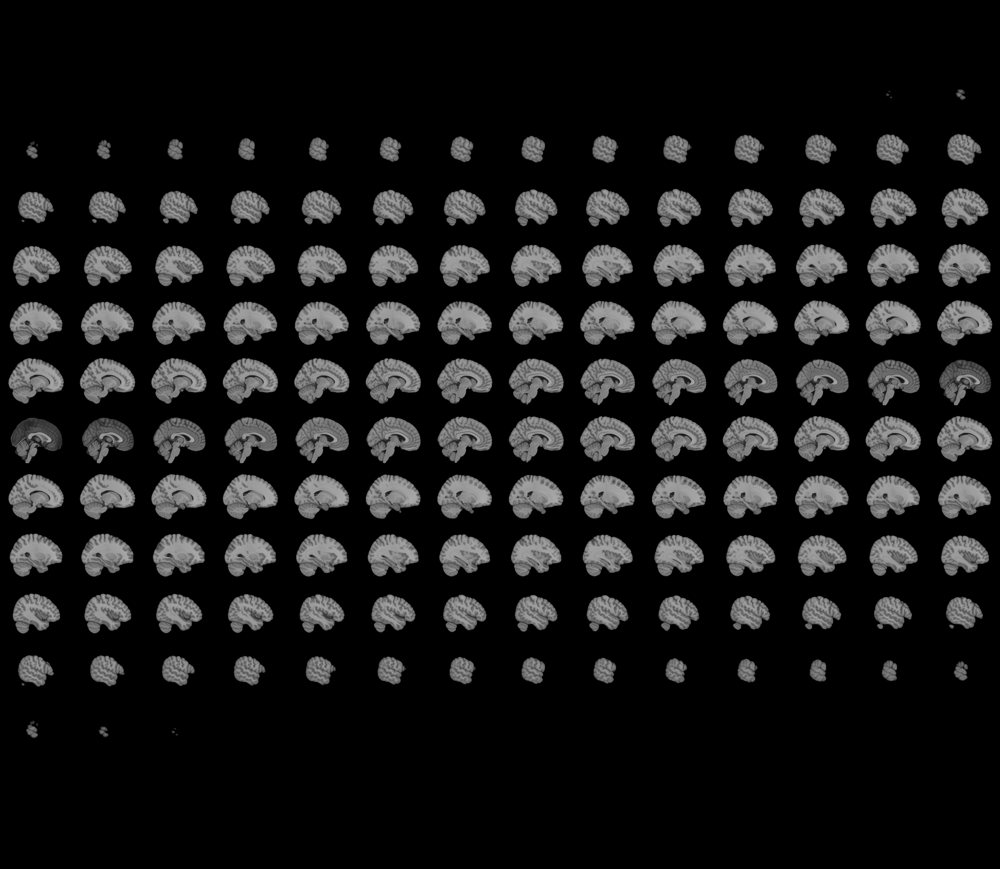
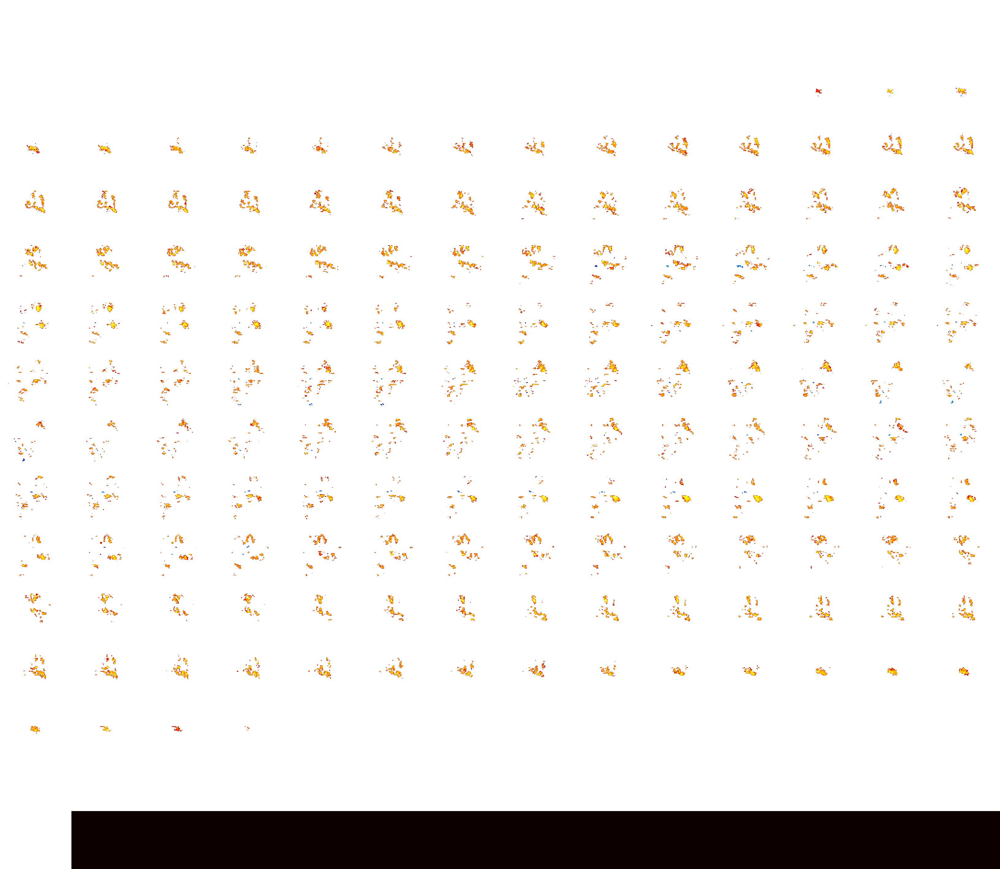

In [37]:
plotting.view_img(thresholded_map, 
                  threshold=zthresh, 
                  bg_img=mni152_template,
                  cut_coords=[-54, -22, 6],
                  title='Mand sound > baseline')

Test lower threshold:

/bgfs/bchandrasekaran/krs228/software/miniconda3/envs/py3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:758: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



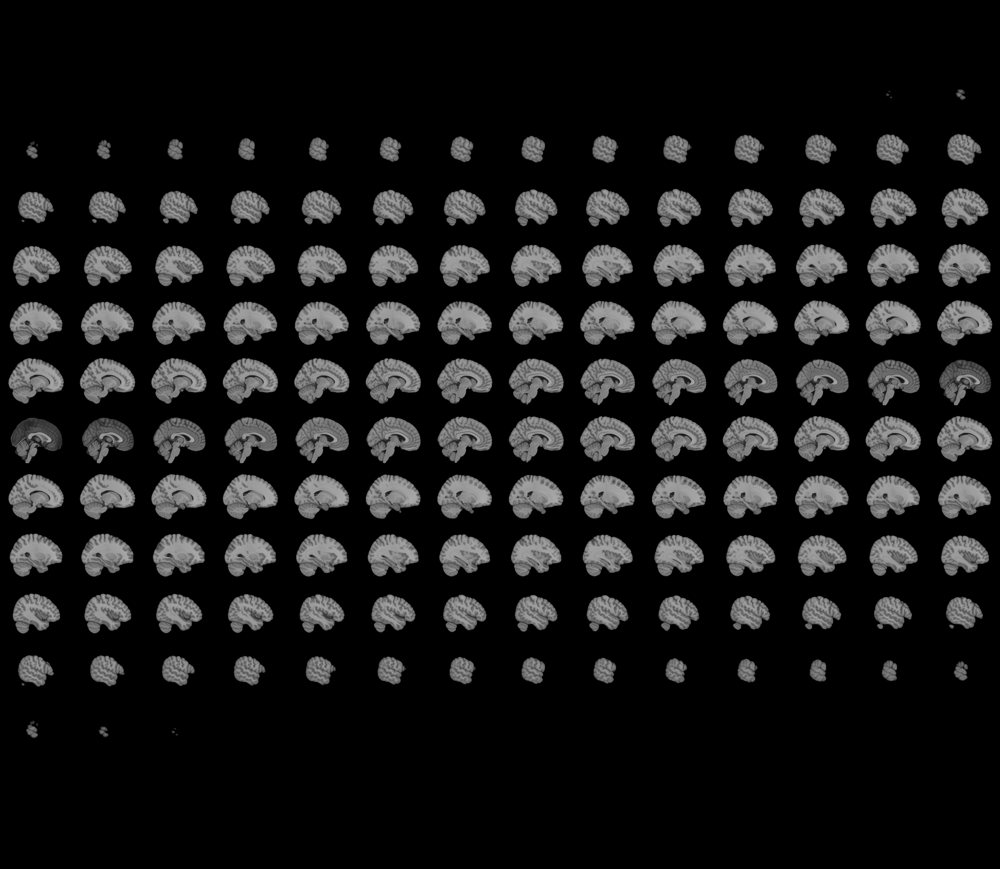
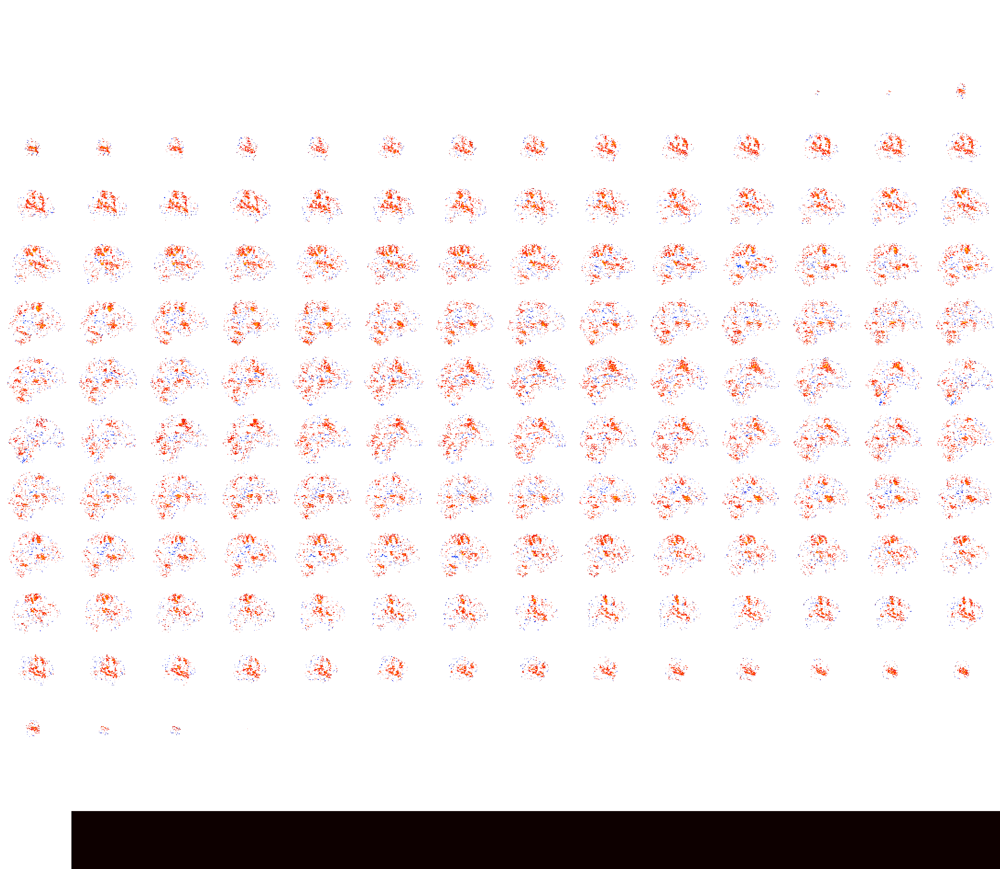

In [18]:
plotting.view_img(z_map, 
                  threshold=2, 
                  bg_img=mni152_template,
                  cut_coords=[-54, -22, 6],
                  title='Mand sound > baseline')

#### Surface plots:

Mandarin-speaking group (n=13)
sound > baseline FDR-corrected z map 
p < 0.05, clusters > 10 voxels


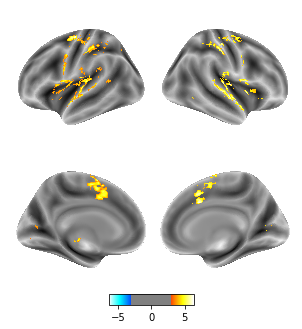

In [38]:
print(plot_title)
plotting.plot_img_on_surf(thresholded_map,
                          surf_mesh='fsaverage',
                          views=['lateral', 'medial'],
                          hemispheres=['left', 'right'],
                          inflate=True,
                          threshold=zthresh,
                          colorbar=True,)
plotting.show()

#### High-res pial surface

In [ ]:
fig2, axes2 = plt.subplots(nrows=2, ncols=2, subplot_kw={"projection": "3d"}, figsize=(5,3), dpi=300)
fig2.suptitle(plot_title, fontsize=10);

texture_left = surface.vol_to_surf(thresholded_map, fsaverage.pial_left)
texture_right = surface.vol_to_surf(thresholded_map, fsaverage.pial_right)

# left hemisphere lateral view
plotting.plot_surf_stat_map(fsaverage.infl_left, texture_left, hemi='left',
                            #title='{} group – {} contrast'.format(group, contrast),
                            vmax=6,
                            colorbar=False,
                            threshold=zthresh, 
                            view='lateral',
                            bg_map=fsaverage.sulc_left, 
                            axes=axes2[0,0], 
                            fig=fig2
                            )

# right hemisphere lateral view
plotting.plot_surf_stat_map(fsaverage.infl_right, texture_right, hemi='right',
                            #title='{} group – {} contrast'.format(group, contrast),
                            #colorbar=True,
                            vmax=6,
                            colorbar=False,
                            threshold=zthresh, 
                            view='lateral',
                            bg_map=fsaverage.sulc_right, 
                            axes=axes2[0,1], 
                            fig=fig2
                            )

# left hemisphere medial view
plotting.plot_surf_stat_map(fsaverage.infl_left, texture_left, hemi='left',
                            #title='{} group – {} contrast'.format(group, contrast),
                            vmax=6,
                            colorbar=False,
                            threshold=zthresh, 
                            view='medial',
                            bg_map=fsaverage.sulc_left, 
                            axes=axes2[1,0], 
                            fig=fig2
                            )

# right hemisphere medial view
plotting.plot_surf_stat_map(fsaverage.infl_right, texture_right, hemi='right',
                            #title='{} group – {} contrast'.format(group, contrast),
                            #colorbar=True,
                            vmax=6,
                            colorbar=False,
                            threshold=zthresh, 
                            view='medial',
                            bg_map=fsaverage.sulc_right, 
                            axes=axes2[1,1], 
                            fig=fig2
                            )
fig2.tight_layout()
fig2.show()
fig2.savefig(os.path.join(group_out_dir,
                     'group-Mand_space-{}_contrast-{}_view-surface.png'.format(space_label, contrast_label)))

#### High-res subcortical slices

In [ ]:
fig1, ax1 = plt.subplots(figsize=(5,2), dpi=300)
plotting.plot_stat_map(thresholded_map,
                       bg_img=mni152_template,
                       threshold=zthresh,
                       vmax=6,
                       cut_coords=[-10, -4, 2, 8, 14],
                       display_mode='z',
                       colorbar=False, 
                       draw_cross=False, 
                       black_bg=False,
                       axes=ax1)
fig1.savefig(os.path.join(group_out_dir,
                     'group-Mand_space-{}_contrast-{}_view-axial-subcort.png'.format(space_label, contrast_label)))

### Non-Mandarin speaking group:

#### Using combined GLM, with contrast isolating non-Mandarin-speaking group

In [39]:
second_level_model = SecondLevelModel(smoothing_fwhm=3).fit(l1_fnames_groupdiff, design_matrix=design_mat_groupdiff)

z_map = second_level_model.compute_contrast(second_level_contrast=[0, 1], output_type='z_score')

In [40]:
# threshold the second-level stats image
alpha = 0.05
cthresh = 10
cluster_correct = 'fdr'

thresholded_map, zthresh = threshold_stats_img(
                            z_map,
                            alpha=alpha,
                            height_control=cluster_correct,
                            cluster_threshold=cthresh,
                            two_sided=True,
                        )

In [27]:
'''
group_label = 'NMan'
z_fpath   = os.path.join(group_out_dir,
                         'group-{}_space-{}_contrast-{}_LSS_map-zstat.nii.gz'.format(group_label, space_label, contrast_label))
thr_fpath = os.path.join(group_out_dir,
                         'group-{}_space-{}_contrast-{}_LSS_alpha-{}_correct-{}_cthresh-{}_map-zstat.nii.gz'.format(group_label, space_label, 
                                                                                                                contrast_label, alpha, 
                                                                                                                cluster_correct, cthresh))

nib.save(z_map, z_fpath)
nib.save(thresholded_map, thr_fpath)
'''

In [41]:
plot_title = ('Non-Mandarin-speaking group (n=%d)\n'
              '%s > baseline FDR-corrected z map \n'
              'p < %.02f, clusters > %d voxels'%(len(sub_list_nman), contrast_label, alpha, cthresh))

The fdr=0.05 threshold is 2.67


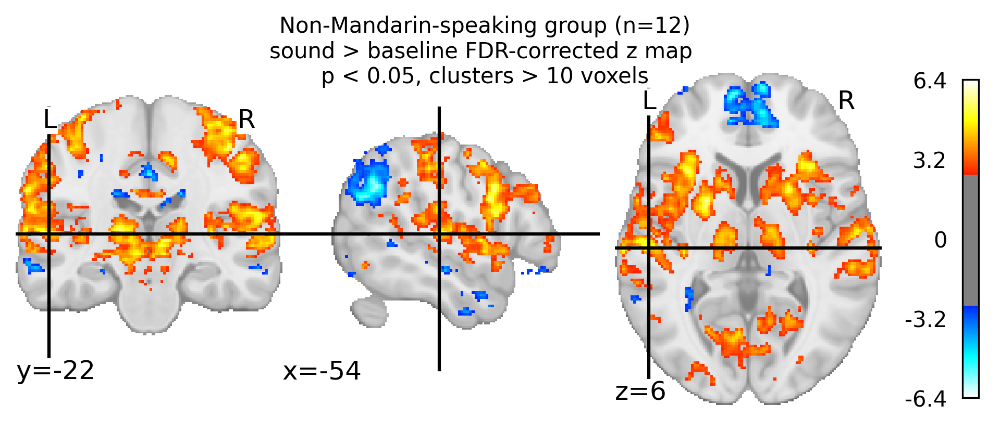

In [42]:
fig, ax = plt.subplots(figsize=(8,3), dpi=300)

plotting.plot_stat_map(
    thresholded_map, 
    threshold=zthresh,
    bg_img=mni152_template,
    black_bg=False,
    cut_coords=[-54, -22, 6],
    #display_mode='mosaic',
    #title=plot_title,
    axes=ax)
fig.suptitle(plot_title, fontsize=10);
print('The %s=%.3g threshold is %.3g' %(cluster_correct, alpha, zthresh))
#fig.savefig(os.path.join(group_out_dir,
#                     'group-{}_space-{}_contrast-{}_view-ortho.png'.format(group_label, space_label, contrast_label)))

Interactive viewer:

/bgfs/bchandrasekaran/krs228/software/miniconda3/envs/py3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:758: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



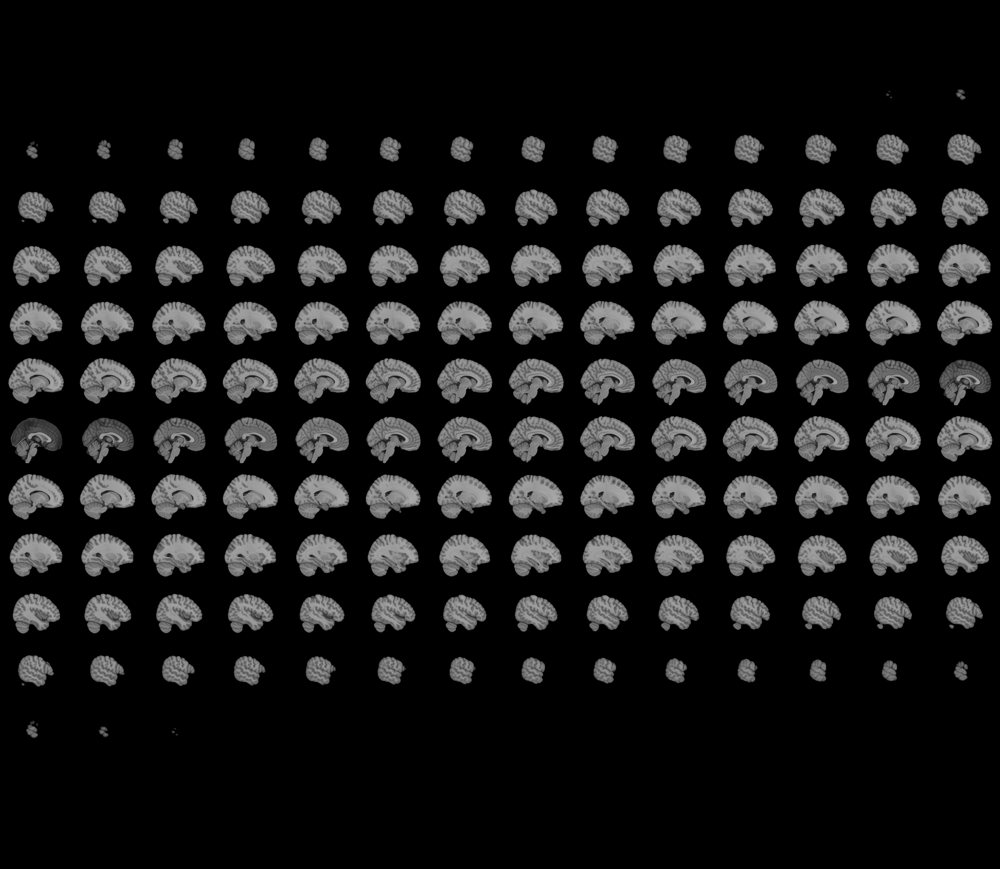
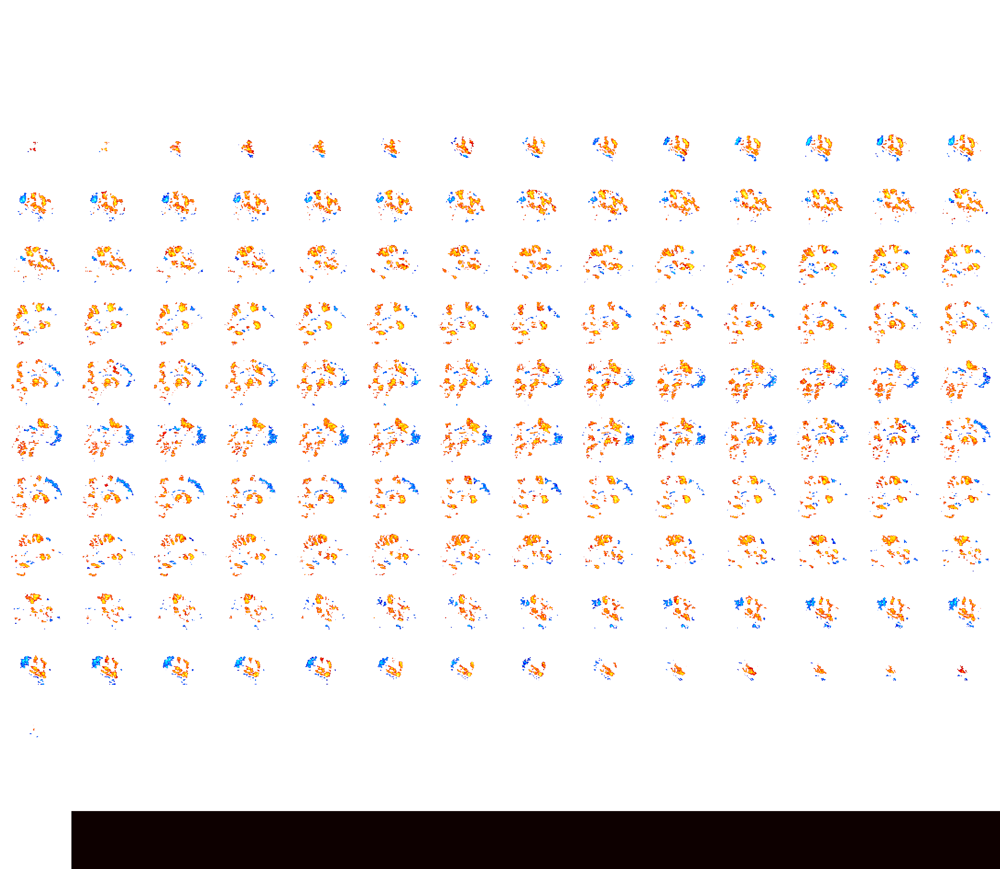

In [43]:
plotting.view_img(thresholded_map, 
                  threshold=zthresh, 
                  bg_img=mni152_template,
                  cut_coords=[-54, -22, 6],
                  title='NMan sound > baseline')

Test lower threshold:

/bgfs/bchandrasekaran/krs228/software/miniconda3/envs/py3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:758: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



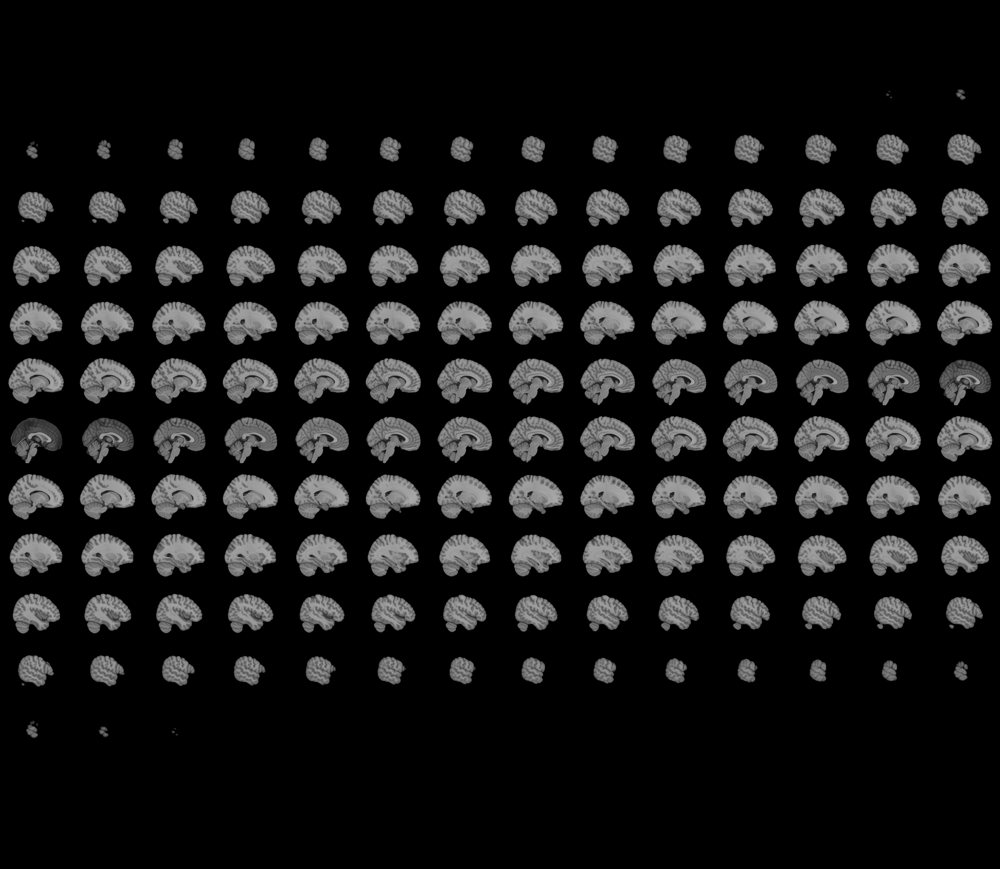
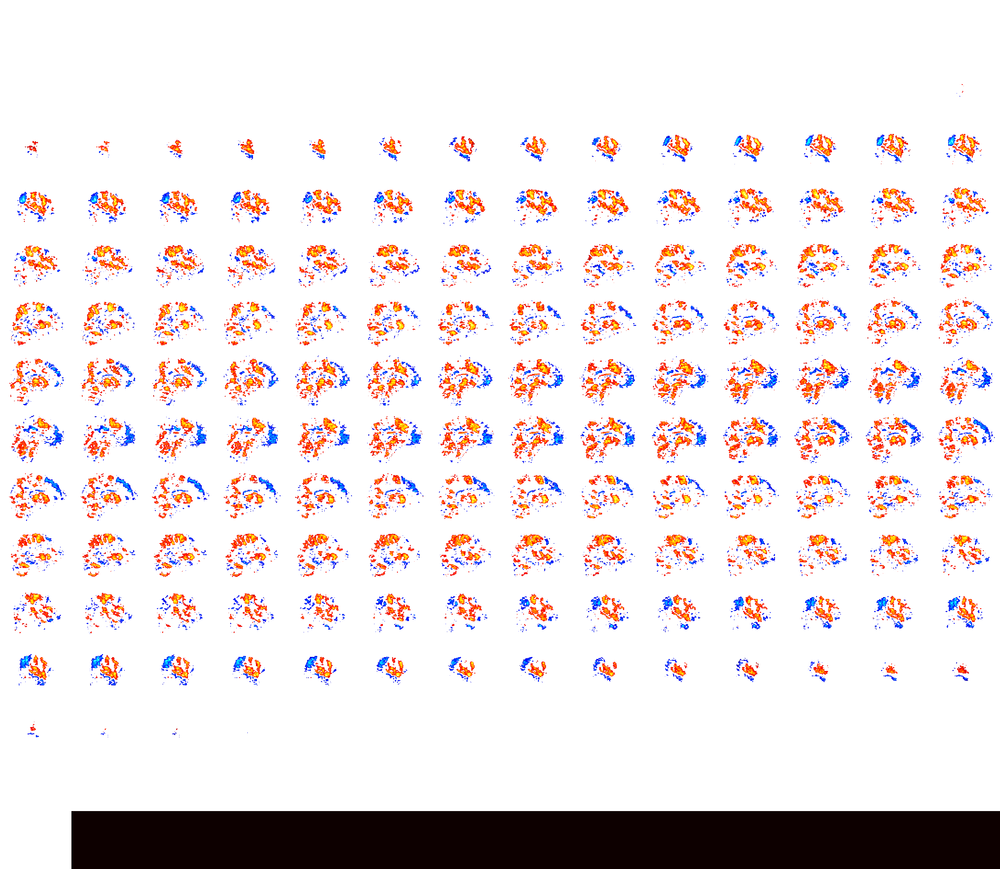

In [44]:
plotting.view_img(z_map, 
                  threshold=2, 
                  bg_img=mni152_template,
                  cut_coords=[-54, -22, 6],
                  title='NMan sound > baseline')

#### Surface plots:

Non-Mandarin-speaking group (n=12)
sound > baseline FDR-corrected z map 
p < 0.05, clusters > 10 voxels


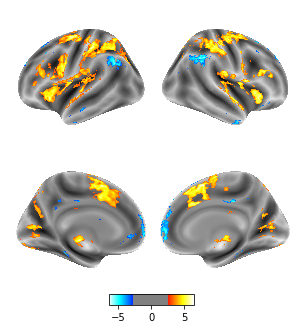

In [45]:
print(plot_title)
plotting.plot_img_on_surf(thresholded_map,
                          surf_mesh='fsaverage',
                          views=['lateral', 'medial'],
                          hemispheres=['left', 'right'],
                          inflate=True,
                          threshold=zthresh,
                          colorbar=True,)
plotting.show()

#### High-res pial surface

In [ ]:
fig2, axes2 = plt.subplots(nrows=2, ncols=2, subplot_kw={"projection": "3d"}, figsize=(5,3), dpi=300)
fig2.suptitle(plot_title, fontsize=10)

texture_left = surface.vol_to_surf(thresholded_map, fsaverage.pial_left)
texture_right = surface.vol_to_surf(thresholded_map, fsaverage.pial_right)

# left hemisphere lateral view
plotting.plot_surf_stat_map(fsaverage.infl_left, texture_left, hemi='left',
                            #title='{} group – {} contrast'.format(group, contrast),
                            vmax=6,
                            colorbar=False,
                            threshold=zthresh, 
                            view='lateral',
                            bg_map=fsaverage.sulc_left, 
                            axes=axes2[0,0], 
                            fig=fig2
                            )

# right hemisphere lateral view
plotting.plot_surf_stat_map(fsaverage.infl_right, texture_right, hemi='right',
                            #title='{} group – {} contrast'.format(group, contrast),
                            #colorbar=True,
                            vmax=6,
                            colorbar=False,
                            threshold=zthresh, 
                            view='lateral',
                            bg_map=fsaverage.sulc_right, 
                            axes=axes2[0,1], 
                            fig=fig2
                            )

# left hemisphere medial view
plotting.plot_surf_stat_map(fsaverage.infl_left, texture_left, hemi='left',
                            #title='{} group – {} contrast'.format(group, contrast),
                            vmax=6,
                            colorbar=False,
                            threshold=zthresh, 
                            view='medial',
                            bg_map=fsaverage.sulc_left, 
                            axes=axes2[1,0], 
                            fig=fig2
                            )

# right hemisphere medial view
plotting.plot_surf_stat_map(fsaverage.infl_right, texture_right, hemi='right',
                            #title='{} group – {} contrast'.format(group, contrast),
                            #colorbar=True,
                            vmax=6,
                            colorbar=False,
                            threshold=zthresh, 
                            view='medial',
                            bg_map=fsaverage.sulc_right, 
                            axes=axes2[1,1], 
                            fig=fig2
                            )
fig2.tight_layout()
fig2.show()
fig2.savefig(os.path.join(group_out_dir,
                     'group-{}_space-{}_contrast-{}_LSS_view-surface.png'.format(group_label, space_label, contrast_label)))

#### High-res subcortical slices

Non-Mandarin-speaking group (n=12)
sound > baseline FDR-corrected z map 
p < 0.05, clusters > 10 voxels


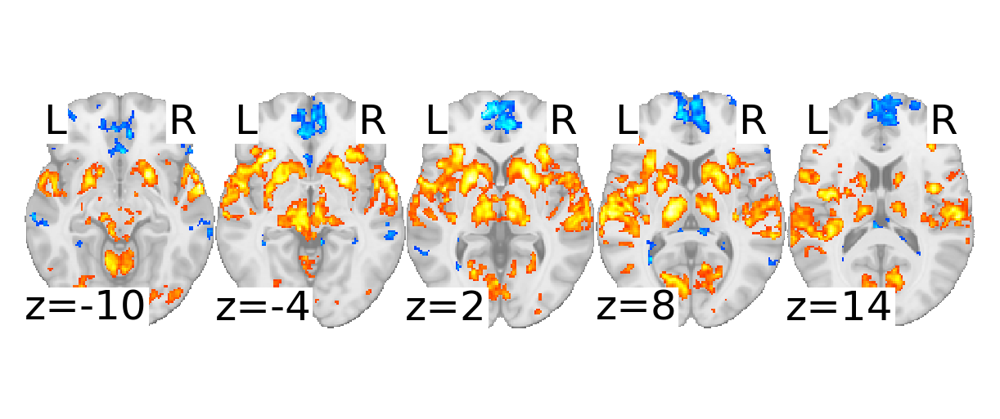

In [46]:
fig1, ax1 = plt.subplots(figsize=(5,2), dpi=300)
print(plot_title)
plotting.plot_stat_map(thresholded_map,
                       bg_img=mni152_template,
                       threshold=zthresh,
                       vmax=6,
                       cut_coords=[-10, -4, 2, 8, 14],
                       display_mode='z',
                       colorbar=False, 
                       draw_cross=False, 
                       black_bg=False,
                       axes=ax1)
fig1.savefig(os.path.join(group_out_dir,
                     'group-{}_space-{}_contrast-{}_LSS_view-axial-subcort.png'.format(group_label, space_label, contrast_label)))

### Group differences

In [47]:
second_level_model = SecondLevelModel(smoothing_fwhm=3).fit(l1_fnames_groupdiff, design_matrix=design_mat_groupdiff)

z_map = second_level_model.compute_contrast(second_level_contrast=[1, -1], output_type='z_score')

In [60]:
# threshold the second-level stats image
alpha = 0.05
cthresh = 10
cluster_correct = None # 'fdr' # 

thresholded_map, zthresh = threshold_stats_img(
                            z_map,
                            alpha=alpha,
                            height_control=cluster_correct,
                            cluster_threshold=cthresh,
                            two_sided=True,
                        )

In [61]:
group_label = 'Mand-vs-NMan'
z_fpath   = os.path.join(group_out_dir,
                         'group-{}_space-{}_contrast-{}_LSS_map-zstat.nii.gz'.format(group_label, space_label, contrast_label))
thr_fpath = os.path.join(group_out_dir,
                         'group-{}_space-{}_contrast-{}_LSS_alpha-{}_correct-{}_cthresh-{}_map-zstat.nii.gz'.format(group_label, space_label, 
                                                                                                                contrast_label, alpha, 
                                                                                                                cluster_correct, cthresh))

nib.save(z_map, z_fpath)
nib.save(thresholded_map, thr_fpath)

In [62]:
plot_title = ('Mand (n=%d) vs. NMan (n=%d) group differences\n'
              '%s > baseline %s-corrected z map \n'
              'p < %.02f, clusters > %d voxels'%(len(sub_list_mand), len(sub_list_nman), 
                                                 contrast_label, cluster_correct, alpha, cthresh))

The None=0.05 threshold is 3


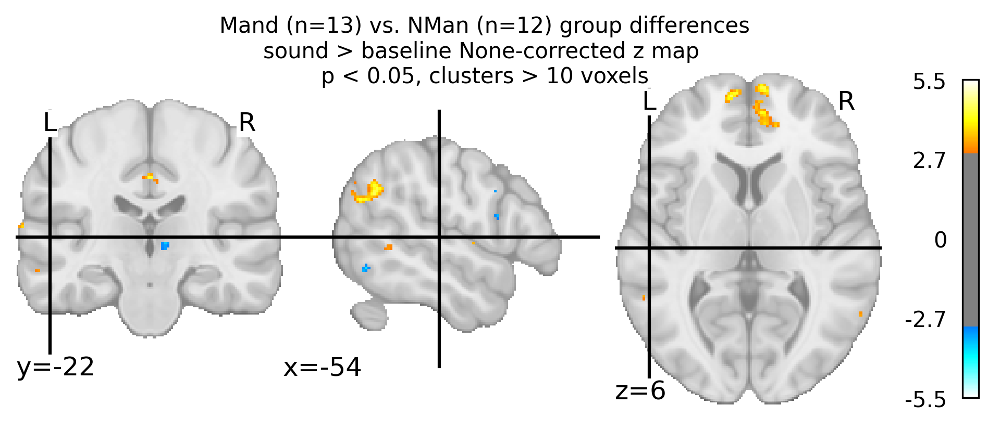

In [63]:
fig, ax = plt.subplots(figsize=(8,3), dpi=300)

plotting.plot_stat_map(
    thresholded_map, 
    threshold=zthresh,
    bg_img=mni152_template,
    black_bg=False,
    cut_coords=[-54, -22, 6],
    #display_mode='mosaic',
    #title=plot_title,
    axes=ax)
fig.suptitle(plot_title, fontsize=10);
print('The %s=%.3g threshold is %.3g' %(cluster_correct, alpha, zthresh))
#fig.savefig(os.path.join(group_out_dir,
#                     'group-{}_space-{}_contrast-{}_view-ortho.png'.format(group_label, space_label, contrast_label)))

Interactive viewer:

/bgfs/bchandrasekaran/krs228/software/miniconda3/envs/py3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:758: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)
/bgfs/bchandrasekaran/krs228/software/miniconda3/envs/py3/lib/python3.9/site-packages/nilearn/plotting/html_document.py:59: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  warnings.warn('It seems you have created more than {} '



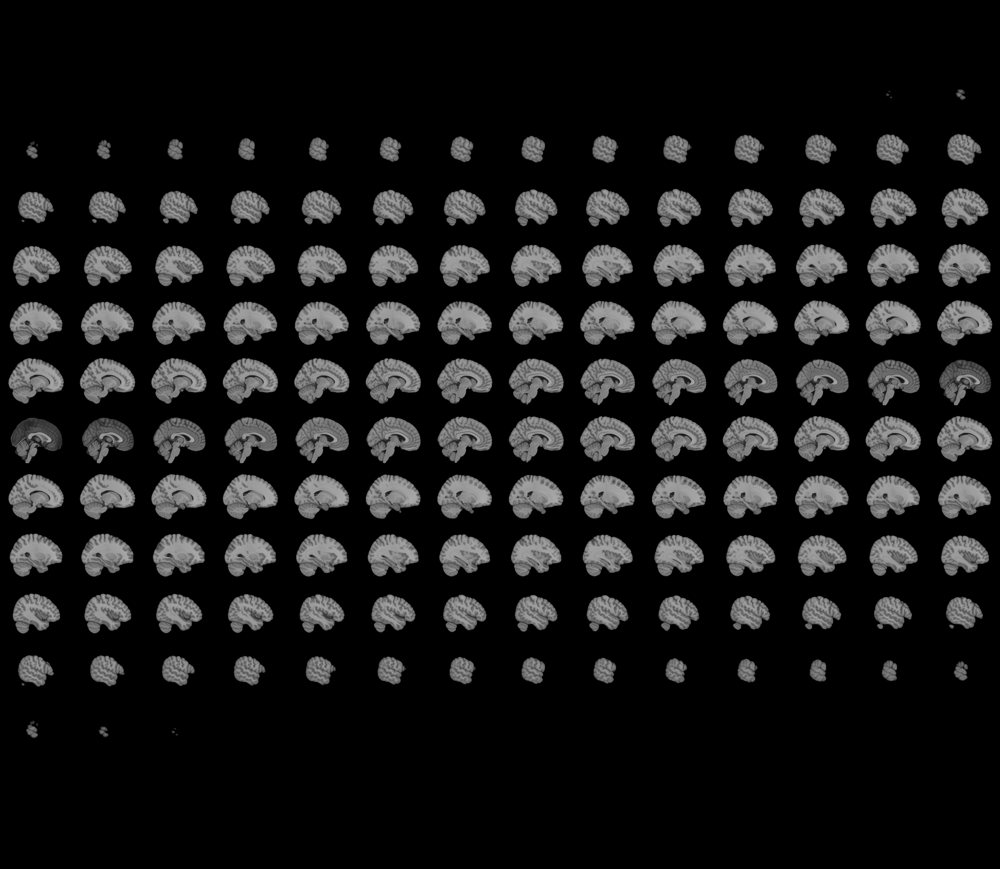
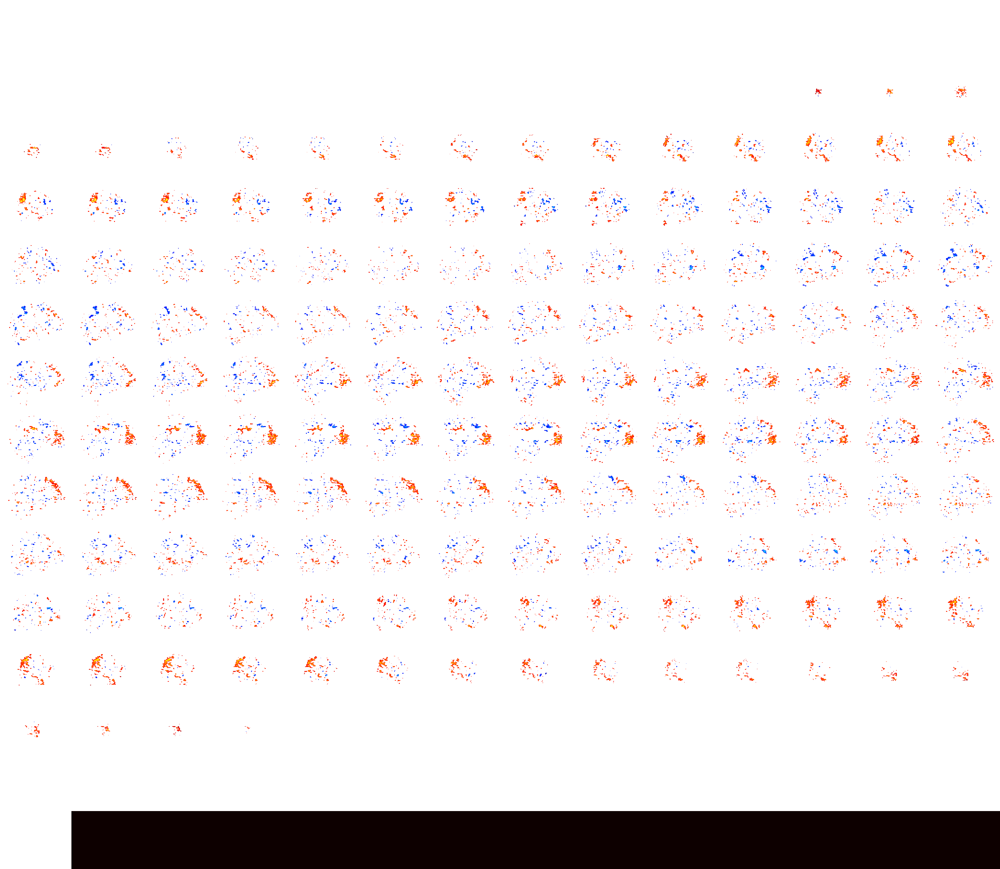

In [59]:
plotting.view_img(z_map, #thresholded_map, 
                  threshold=2., # threshold
                  bg_img=mni152_template,
                  cut_coords=[-54, -22, 6],
                  title='Mand > NMan sound > baseline')

# TEST: between-runs analysis

### Mandarin-speaking group:

#### Get files

In [15]:
print(contrast_label)

sound


In [24]:
sub_list_mand

['sub-FLT03',
 'sub-FLT05',
 'sub-FLT08',
 'sub-FLT10',
 'sub-FLT15',
 'sub-FLT17',
 'sub-FLT18',
 'sub-FLT19',
 'sub-FLT21',
 'sub-FLT22',
 'sub-FLT23',
 'sub-FLT24',
 'sub-FLT26']

In [25]:
# get the beta map for the contrast of interest for each subject
fwhm=0.00
l1_dir = os.path.join(nilearn_dir, 'level-1_fwhm-%.02f'%fwhm)
print(l1_dir)
fnames_early_mand = [sorted(glob(l1_dir+'/%s_space-%s/grouped_runs/earlythird/*%s_map-beta.nii.gz'%(sub_id, space_label, contrast_label)))[0] for sub_id in sub_list_mand]
fnames_late_mand = [sorted(glob(l1_dir+'/%s_space-%s/grouped_runs/latethird/*%s_map-beta.nii.gz'%(sub_id, space_label, contrast_label)))[0] for sub_id in sub_list_mand]

/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00


In [59]:
fnames_mand = [sorted(glob(l1_dir+'/%s_space-%s/grouped_runs/*third/*%s_map-beta.nii.gz'%(sub_id, space_label, contrast_label)))[0:2] for sub_id in sub_list_mand]

flat_list_mand = [item for sublist in fnames_mand for item in sublist]
print(flat_list_mand)

['/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT03_space-MNI152NLin2009cAsym/grouped_runs/earlythird/sub-FLT03_task-tonecat_fwhm-0.00_space-MNI152NLin2009cAsym_contrast-sound_map-beta.nii.gz', '/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT03_space-MNI152NLin2009cAsym/grouped_runs/latethird/sub-FLT03_task-tonecat_fwhm-0.00_space-MNI152NLin2009cAsym_contrast-sound_map-beta.nii.gz', '/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT05_space-MNI152NLin2009cAsym/grouped_runs/earlythird/sub-FLT05_task-tonecat_fwhm-0.00_space-MNI152NLin2009cAsym_contrast-sound_map-beta.nii.gz', '/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT05_space-MNI152NLin2009cAsym/grouped_runs/latethird/sub-FLT05_task-tonecat_fwhm-0.00_space-MNI152NLin2009cAsym_contrast-sound_map-beta.nii.gz', '/bgfs/bchandrasekaran/krs228

In [50]:
split_list = [x%2-0.5 for x in range(2*len(sub_list_mand))]
split_df = pd.DataFrame({'split':split_list})

mand_sub_split_dict = {}
for sx, sub in enumerate(sub_list_mand):
    sub_ind_list = np.zeros(2*len(sub_list_mand))
    sub_ind_list[2*sx:2*sx+2] = 1
    
    mand_sub_split_dict[sub] = sub_ind_list
mand_sub_split_dict

mand_sub_split_df = pd.DataFrame(mand_sub_split_dict)

mand_split_df = pd.concat([split_df, mand_sub_split_df], axis=1)

In [51]:
mand_split_df

,split,sub-FLT03,sub-FLT05,sub-FLT08,sub-FLT10,sub-FLT15,sub-FLT17,sub-FLT18,sub-FLT19,sub-FLT21,sub-FLT22,sub-FLT23,sub-FLT24,sub-FLT26
0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,1,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,1,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,1,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,1,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


#### Using combined GLM, with contrast isolating Mandarin group

In [68]:
contrast_array = np.concatenate([[1,], np.zeros(len(sub_list_mand))])
print(contrast_array)           

[1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


In [69]:
# create a model object
second_level_model = SecondLevelModel().fit(flat_list_mand, design_matrix=mand_split_df)

# fit the model with our contrast of interest
z_map = second_level_model.compute_contrast(second_level_contrast=contrast_array, output_type='z_score')

In [76]:
# threshold the second-level stats image
alpha = 0.05
cthresh = 10
cluster_correct = None #'fdr'

thresholded_map, zthresh = threshold_stats_img(
                            z_map,
                            alpha=alpha,
                            height_control=cluster_correct,
                            cluster_threshold=cthresh,
                            two_sided=True,
                        )

In [77]:
plot_title = ('Mandarin-speaking group (n=%d)\n'
              'early vs. late \n'
              '%s > baseline FDR-corrected z map \n'
              'p < %.02f, clusters > %d voxels'%(len(sub_list_mand), contrast_label, alpha, cthresh))

/bgfs/bchandrasekaran/krs228/software/miniconda3/envs/py3/lib/python3.9/site-packages/nilearn/plotting/displays/_slicers.py:382: UserWarning: empty mask
  get_mask_bounds(new_img_like(img, not_mask, affine))


The None=0.05 threshold is 3


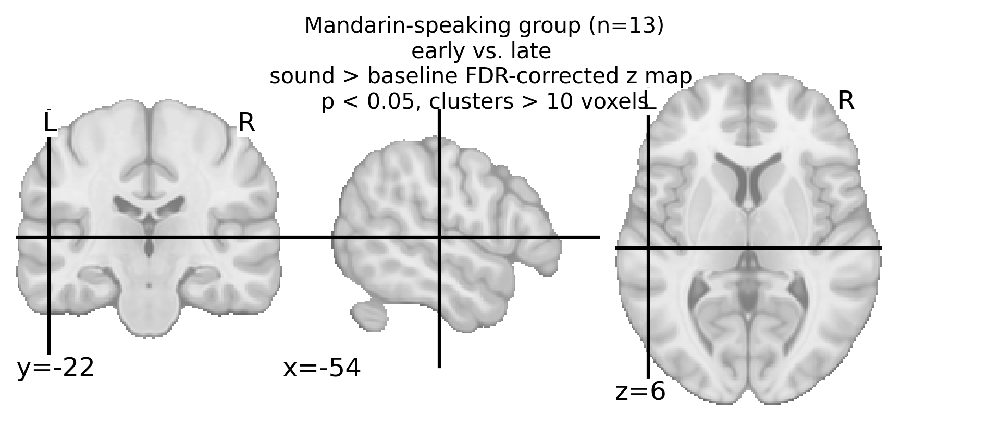

In [78]:
fig, ax = plt.subplots(figsize=(8,3), dpi=300)

plotting.plot_stat_map(
    thresholded_map, 
    threshold=zthresh,
    bg_img=mni152_template,
    black_bg=False,
    cut_coords=[-54, -22, 6],
    #display_mode='mosaic',
    #title=plot_title,
    axes=ax)
fig.suptitle(plot_title, fontsize=10);
print('The %s=%.3g threshold is %.3g' %(cluster_correct, alpha, zthresh))
#fig.savefig(os.path.join(group_out_dir,
#                     'group-Mand_space-{}_contrast-{}_view-ortho.png'.format(space_label, contrast_label)))

Interactive viewer:

/bgfs/bchandrasekaran/krs228/software/miniconda3/envs/py3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:758: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



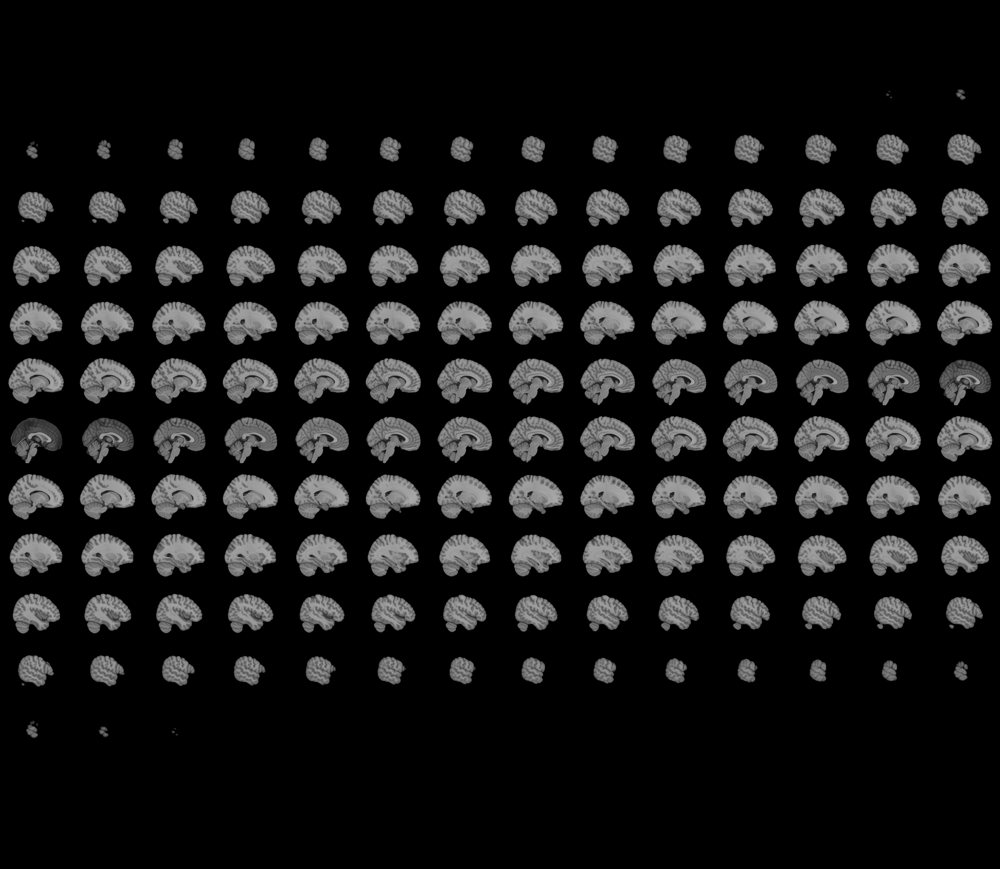
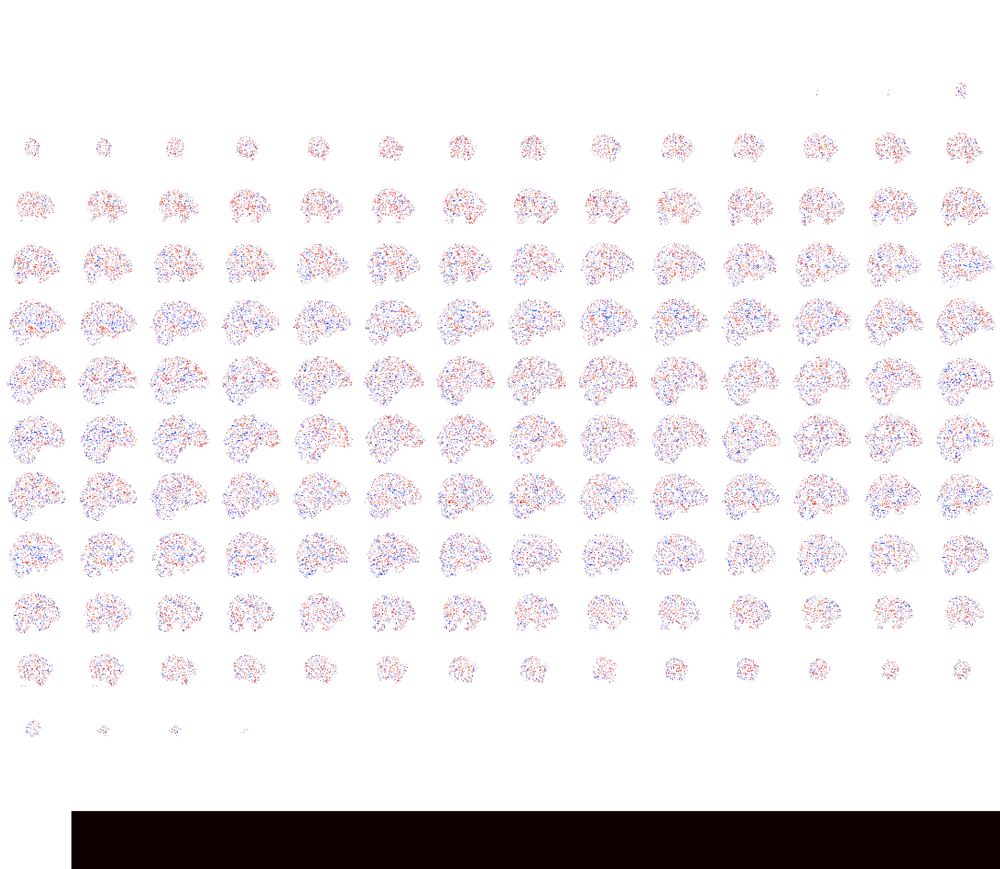

In [81]:
plotting.view_img(z_map, #thresholded_map, 
                  threshold=1.5, #zthresh, 
                  bg_img=mni152_template,
                  cut_coords=[-54, -22, 6],
                  title='Mand early > late sound > baseline')

### Non-Mandarin-speaking group:

#### Get files

In [15]:
print(contrast_label)

sound


In [24]:
sub_list_nman

['sub-FLT03',
 'sub-FLT05',
 'sub-FLT08',
 'sub-FLT10',
 'sub-FLT15',
 'sub-FLT17',
 'sub-FLT18',
 'sub-FLT19',
 'sub-FLT21',
 'sub-FLT22',
 'sub-FLT23',
 'sub-FLT24',
 'sub-FLT26']

In [82]:
# get the beta map for the contrast of interest for each subject
fwhm=0.00
l1_dir = os.path.join(nilearn_dir, 'level-1_fwhm-%.02f'%fwhm)
print(l1_dir)
fnames_early_nman = [sorted(glob(l1_dir+'/%s_space-%s/grouped_runs/earlythird/*%s_map-beta.nii.gz'%(sub_id, space_label, contrast_label)))[0] for sub_id in sub_list_nman]
fnames_late_nman = [sorted(glob(l1_dir+'/%s_space-%s/grouped_runs/latethird/*%s_map-beta.nii.gz'%(sub_id, space_label, contrast_label)))[0] for sub_id in sub_list_nman]

/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00


In [96]:
fnames_nman = [sorted(glob(l1_dir+'/%s_space-%s/grouped_runs/*third/*%s_map-beta.nii.gz'%(sub_id, space_label, contrast_label)))[0:2] for sub_id in sub_list_nman]

flat_list_nman = [item for sublist in fnames_nman for item in sublist]
print(flat_list_nman)

['/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT02_space-MNI152NLin2009cAsym/grouped_runs/earlythird/sub-FLT02_task-tonecat_fwhm-0.00_space-MNI152NLin2009cAsym_contrast-sound_map-beta.nii.gz', '/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT02_space-MNI152NLin2009cAsym/grouped_runs/latethird/sub-FLT02_task-tonecat_fwhm-0.00_space-MNI152NLin2009cAsym_contrast-sound_map-beta.nii.gz', '/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT04_space-MNI152NLin2009cAsym/grouped_runs/earlythird/sub-FLT04_task-tonecat_fwhm-0.00_space-MNI152NLin2009cAsym_contrast-sound_map-beta.nii.gz', '/bgfs/bchandrasekaran/krs228/data/FLT/data_denoised/derivatives/nilearn/level-1_fwhm-0.00/sub-FLT04_space-MNI152NLin2009cAsym/grouped_runs/latethird/sub-FLT04_task-tonecat_fwhm-0.00_space-MNI152NLin2009cAsym_contrast-sound_map-beta.nii.gz', '/bgfs/bchandrasekaran/krs228

In [97]:
split_list = [x%2-0.5 for x in range(2*len(sub_list_nman))]
split_df = pd.DataFrame({'split':split_list})

nman_sub_split_dict = {}
for sx, sub in enumerate(sub_list_nman):
    sub_ind_list = np.zeros(2*len(sub_list_nman))
    sub_ind_list[2*sx:2*sx+2] = 1
    
    nman_sub_split_dict[sub] = sub_ind_list
nman_sub_split_dict

nman_sub_split_df = pd.DataFrame(nman_sub_split_dict)

nman_split_df = pd.concat([split_df, nman_sub_split_df], axis=1)

In [98]:
nman_split_df

,split,sub-FLT02,sub-FLT04,sub-FLT06,sub-FLT09,sub-FLT11,sub-FLT12,sub-FLT13,sub-FLT14,sub-FLT20,sub-FLT25,sub-FLT28,sub-FLT30
0,-0.5,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.5,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,-0.5,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.5,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,-0.5,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,0.5,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,-0.5,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,0.5,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,-0.5,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,0.5,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


#### Using combined GLM, with contrast isolating Mandarin group

In [99]:
contrast_array = np.concatenate([[1,], np.zeros(len(sub_list_nman))])
print(contrast_array)           

[1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


In [100]:
# create a model object
second_level_model = SecondLevelModel().fit(flat_list_nman, design_matrix=nman_split_df)

# fit the model with our contrast of interest
z_map = second_level_model.compute_contrast(second_level_contrast=contrast_array, output_type='z_score')

In [101]:
# threshold the second-level stats image
alpha = 0.05
cthresh = 10
cluster_correct = None #'fdr'

thresholded_map, zthresh = threshold_stats_img(
                            z_map,
                            alpha=alpha,
                            height_control=cluster_correct,
                            cluster_threshold=cthresh,
                            two_sided=True,
                        )

In [102]:
plot_title = ('Non-Mandarin-speaking group (n=%d)\n'
              'early vs. late \n'
              '%s > baseline FDR-corrected z map \n'
              'p < %.02f, clusters > %d voxels'%(len(sub_list_nman), contrast_label, alpha, cthresh))

/bgfs/bchandrasekaran/krs228/software/miniconda3/envs/py3/lib/python3.9/site-packages/nilearn/plotting/displays/_slicers.py:382: UserWarning: empty mask
  get_mask_bounds(new_img_like(img, not_mask, affine))


The None=0.05 threshold is 3


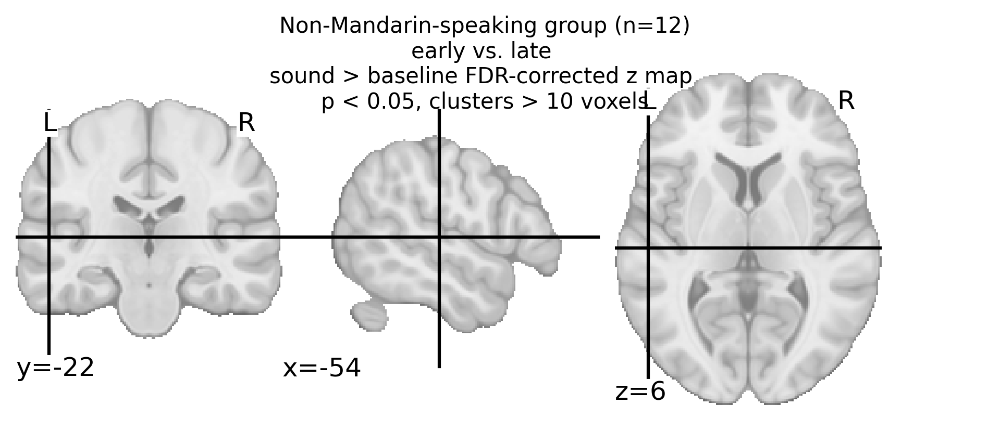

In [103]:
fig, ax = plt.subplots(figsize=(8,3), dpi=300)

plotting.plot_stat_map(
    thresholded_map, 
    threshold=zthresh,
    bg_img=mni152_template,
    black_bg=False,
    cut_coords=[-54, -22, 6],
    #display_mode='mosaic',
    #title=plot_title,
    axes=ax)
fig.suptitle(plot_title, fontsize=10);
print('The %s=%.3g threshold is %.3g' %(cluster_correct, alpha, zthresh))
#fig.savefig(os.path.join(group_out_dir,
#                     'group-Mand_space-{}_contrast-{}_view-ortho.png'.format(space_label, contrast_label)))

Interactive viewer:

/bgfs/bchandrasekaran/krs228/software/miniconda3/envs/py3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:758: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



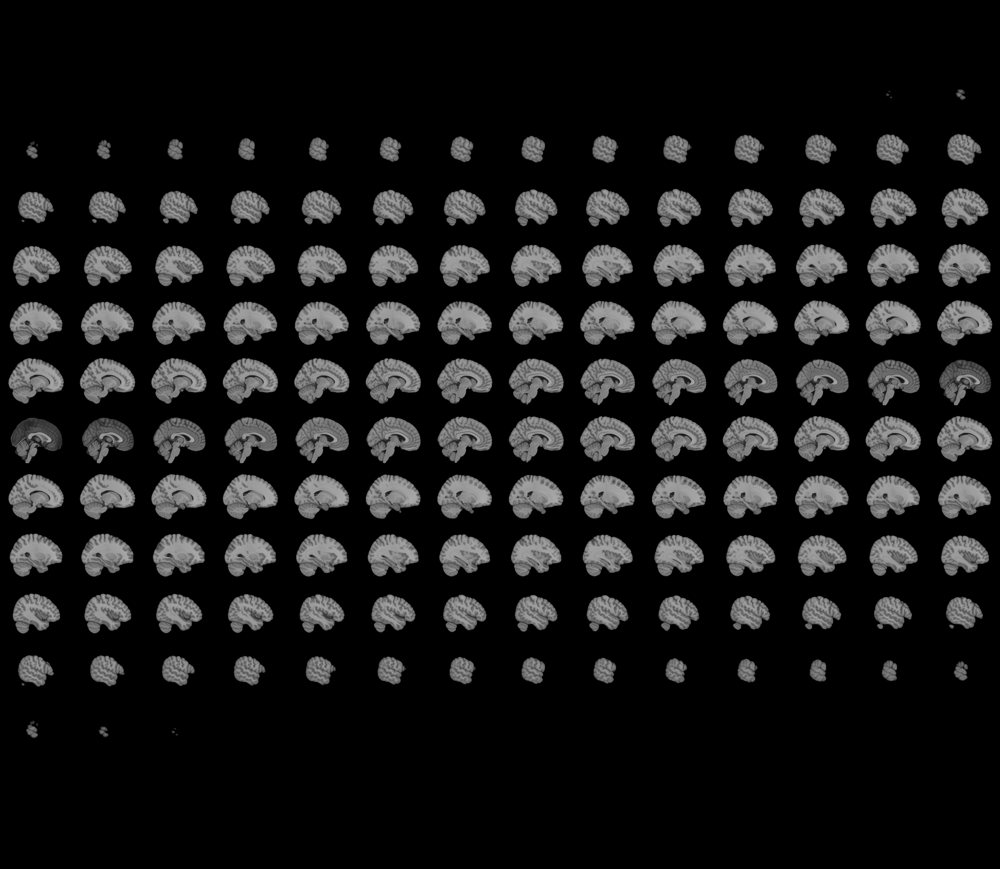
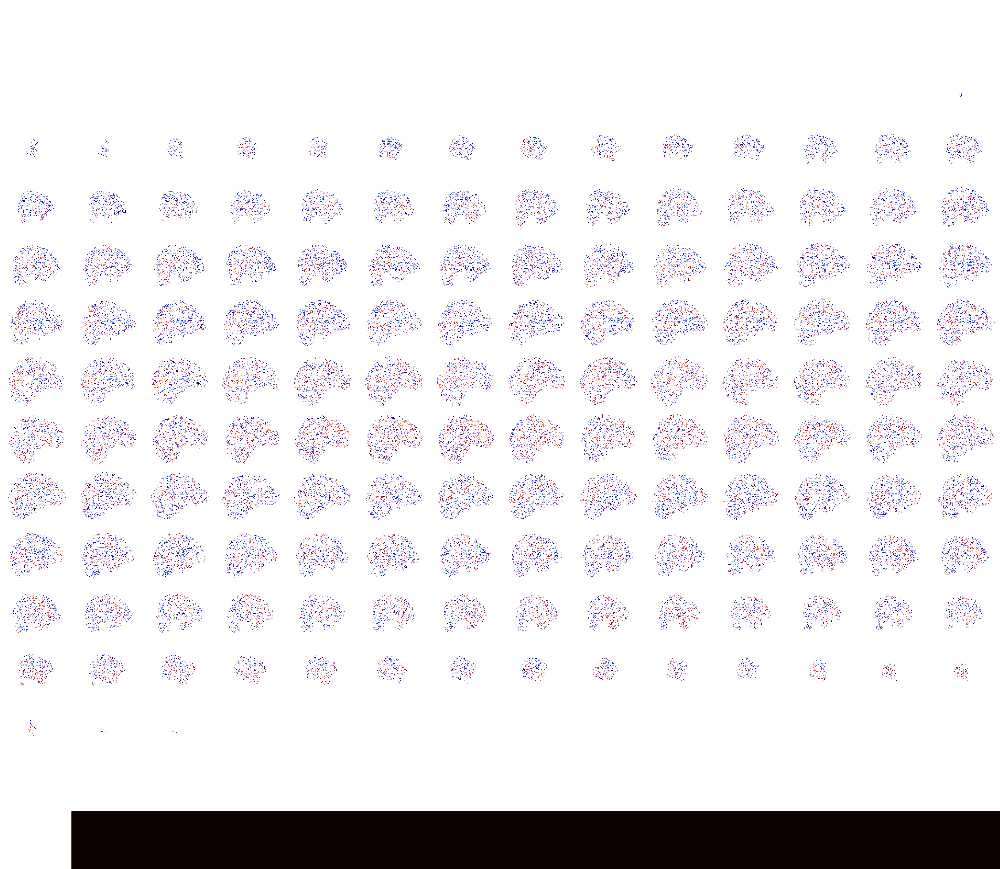

In [104]:
plotting.view_img(z_map, #thresholded_map, 
                  threshold=1.5, #zthresh, 
                  bg_img=mni152_template,
                  cut_coords=[-54, -22, 6],
                  title='Mand early > late sound > baseline')

# Surface plots:

Mand (n=13) vs. NMan (n=12) group differences
sound > baseline FDR-corrected z map 
p < 0.05, clusters > 10 voxels


/bgfs/bchandrasekaran/krs228/software/miniconda3/envs/py3/lib/python3.9/site-packages/nilearn/plotting/surf_plotting.py:421: RuntimeWarning: invalid value encountered in true_divide
  data_copy /= (vmax - vmin)


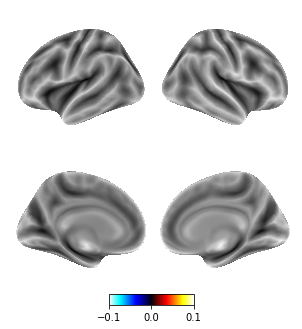

In [34]:
print(plot_title)
plotting.plot_img_on_surf(thresholded_map,
                          surf_mesh='fsaverage',
                          views=['lateral', 'medial'],
                          hemispheres=['left', 'right'],
                          inflate=True,
                          threshold=zthresh,
                          colorbar=True,)
plotting.show()

#### High-res pial surface

In [ ]:
fig2, axes2 = plt.subplots(nrows=2, ncols=2, subplot_kw={"projection": "3d"}, figsize=(5,3), dpi=300)
fig2.suptitle(plot_title, fontsize=10)

texture_left = surface.vol_to_surf(thresholded_map, fsaverage.pial_left)
texture_right = surface.vol_to_surf(thresholded_map, fsaverage.pial_right)

# left hemisphere lateral view
plotting.plot_surf_stat_map(fsaverage.infl_left, texture_left, hemi='left',
                            #title='{} group – {} contrast'.format(group, contrast),
                            vmax=6,
                            colorbar=False,
                            threshold=zthresh, 
                            view='lateral',
                            bg_map=fsaverage.sulc_left, 
                            axes=axes2[0,0], 
                            fig=fig2
                            )

# right hemisphere lateral view
plotting.plot_surf_stat_map(fsaverage.infl_right, texture_right, hemi='right',
                            #title='{} group – {} contrast'.format(group, contrast),
                            #colorbar=True,
                            vmax=6,
                            colorbar=False,
                            threshold=zthresh, 
                            view='lateral',
                            bg_map=fsaverage.sulc_right, 
                            axes=axes2[0,1], 
                            fig=fig2
                            )

# left hemisphere medial view
plotting.plot_surf_stat_map(fsaverage.infl_left, texture_left, hemi='left',
                            #title='{} group – {} contrast'.format(group, contrast),
                            vmax=6,
                            colorbar=False,
                            threshold=zthresh, 
                            view='medial',
                            bg_map=fsaverage.sulc_left, 
                            axes=axes2[1,0], 
                            fig=fig2
                            )

# right hemisphere medial view
plotting.plot_surf_stat_map(fsaverage.infl_right, texture_right, hemi='right',
                            #title='{} group – {} contrast'.format(group, contrast),
                            #colorbar=True,
                            vmax=6,
                            colorbar=False,
                            threshold=zthresh, 
                            view='medial',
                            bg_map=fsaverage.sulc_right, 
                            axes=axes2[1,1], 
                            fig=fig2
                            )
fig2.tight_layout()
fig2.show()
fig2.savefig(os.path.join(group_out_dir,
                     'group-{}_space-{}_contrast-{}_view-surface.png'.format(group_label, space_label, contrast_label)))

#### High-res subcortical slices

In [ ]:
fig1, ax1 = plt.subplots(figsize=(5,2), dpi=300)
print(plot_title)
plotting.plot_stat_map(thresholded_map,
                       bg_img=mni152_template,
                       threshold=zthresh,
                       vmax=6,
                       cut_coords=[-10, -4, 2, 8, 14],
                       display_mode='z',
                       colorbar=False, 
                       draw_cross=False, 
                       black_bg=False,
                       axes=ax1)
fig1.savefig(os.path.join(group_out_dir,
                     'group-{}_space-{}_contrast-{}_view-axial-subcort.png'.format(group_label, space_label, contrast_label)))

## All participants

In [38]:
from nilearn.glm.second_level import SecondLevelModel
second_level_model = SecondLevelModel().fit(l1_fnames_groupdiff, design_matrix=design_mat_groupdiff)

z_map = second_level_model.compute_contrast(second_level_contrast=[1, 1], output_type='z_score')


In [39]:
# threshold the second-level stats image
alpha = 0.05
cthresh = 10
cluster_correct = 'fdr'

thresholded_map, zthresh = threshold_stats_img(
                            z_map,
                            alpha=alpha,
                            height_control=cluster_correct,
                            cluster_threshold=cthresh,
                            two_sided=True,
                        )

In [40]:
group_label = 'all'
z_fpath   = os.path.join(group_out_dir,
                         'group-{}_space-{}_contrast-{}_map-zstat.nii.gz'.format(group_label, space_label, contrast_label))
thr_fpath = os.path.join(group_out_dir,
                         'group-{}_space-{}_contrast-{}_alpha-{}_correct-{}_cthresh-{}_map-zstat.nii.gz'.format(group_label, space_label, 
                                                                                                                 contrast_label, alpha, 
                                                                                                                 cluster_correct, cthresh))

nib.save(z_map, z_fpath)
nib.save(thresholded_map, thr_fpath)

In [41]:
plot_title = ('All participants (n=%d)\n'
              '%s > baseline FDR-corrected z map \n'
              'p < %.02f, clusters > %d voxels'%(len(l1_fnames_groupdiff), 
                                                 contrast_label, alpha, cthresh))

The fdr=0.05 threshold is 2.6


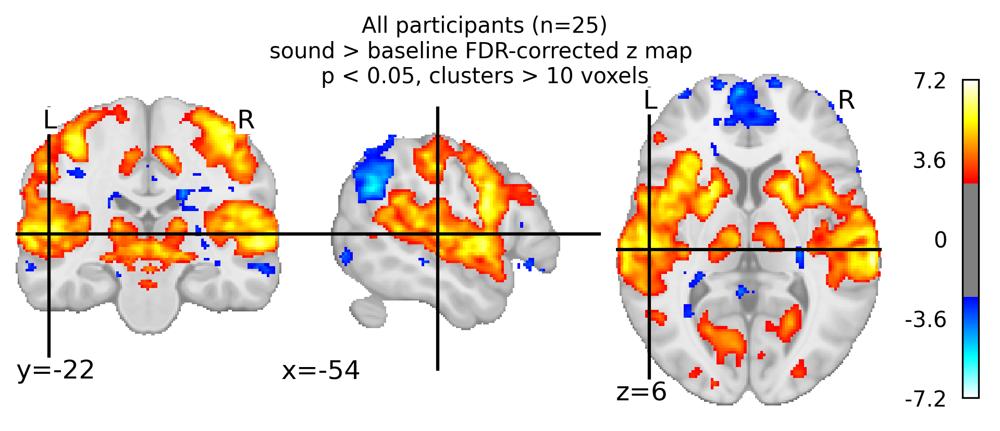

In [42]:
fig, ax = plt.subplots(figsize=(8,3), dpi=300)

plotting.plot_stat_map(
    thresholded_map, 
    threshold=zthresh,
    bg_img=mni152_template,
    black_bg=False,
    cut_coords=[-54, -22, 6],
    #display_mode='mosaic',
    #title=plot_title,
    axes=ax)
fig.suptitle(plot_title, fontsize=10);
print('The %s=%.3g threshold is %.3g' %(cluster_correct, alpha, zthresh))
fig.savefig(os.path.join(group_out_dir,
                     'group-{}_space-{}_contrast-{}_view-ortho.png'.format(group_label, space_label, contrast_label)))

Interactive viewer:

/bgfs/bchandrasekaran/krs228/software/miniconda3/envs/py3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:758: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



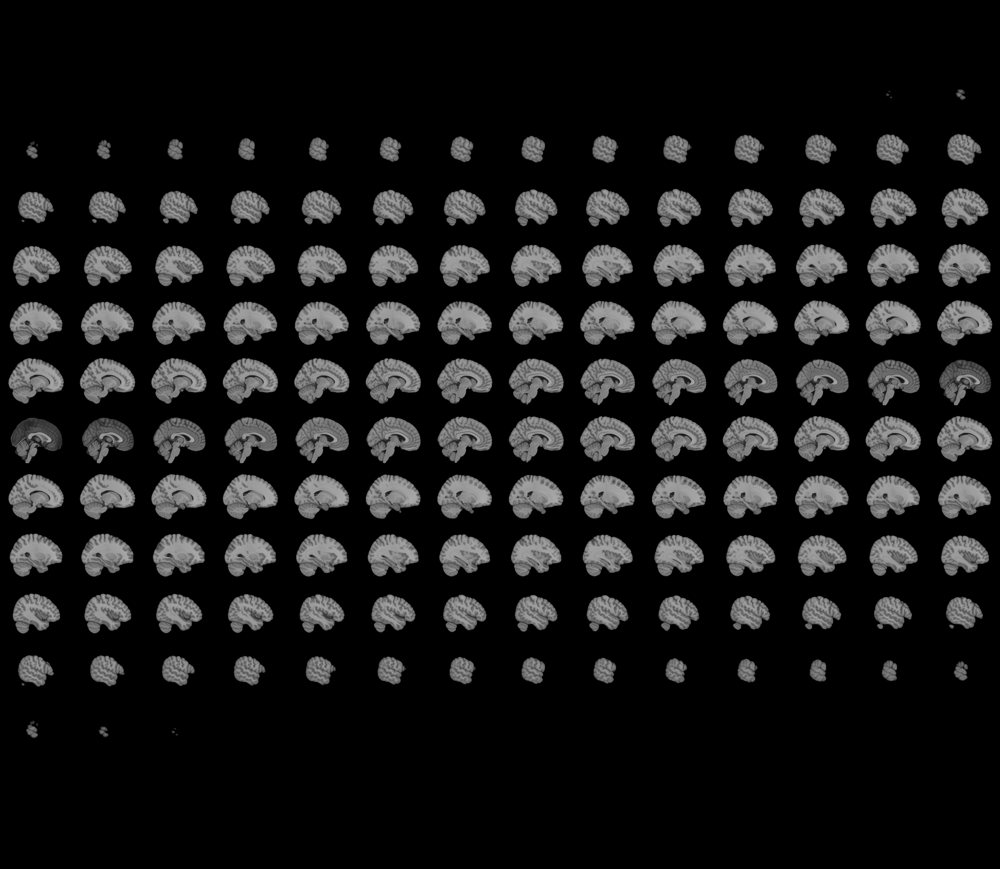
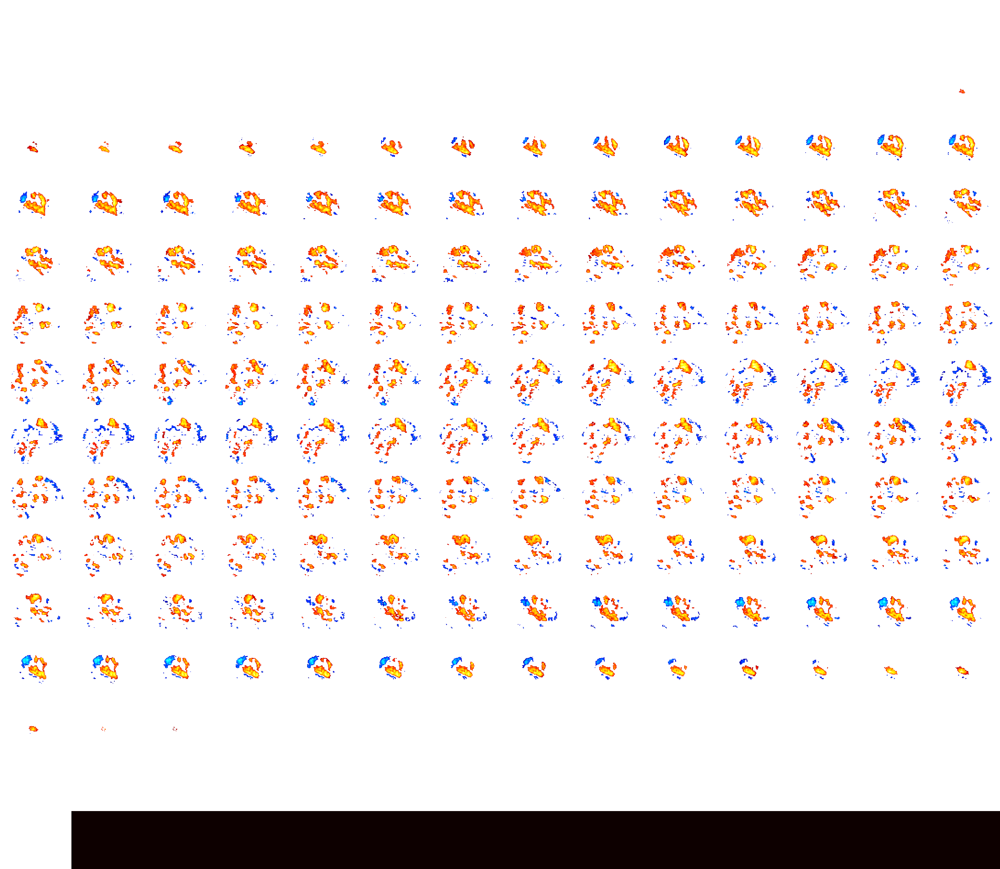

In [45]:
plotting.view_img(thresholded_map, 
                  threshold=zthresh, 
                  bg_img=mni152_template,
                  cut_coords=[-54, -22, 6],
                  title='group-{} sound > baseline'.format(group_label))

#### Surface plots:

All participants (n=25)
sound > baseline FDR-corrected z map 
p < 0.05, clusters > 10 voxels


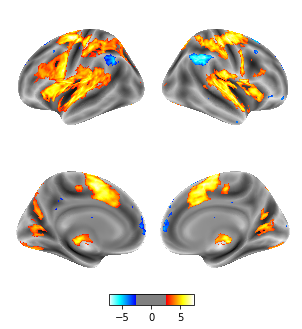

In [46]:
print(plot_title)
plotting.plot_img_on_surf(thresholded_map,
                          surf_mesh='fsaverage',
                          views=['lateral', 'medial'],
                          hemispheres=['left', 'right'],
                          inflate=True,
                          threshold=zthresh,
                          colorbar=True,)
plotting.show()

#### High-res pial surface

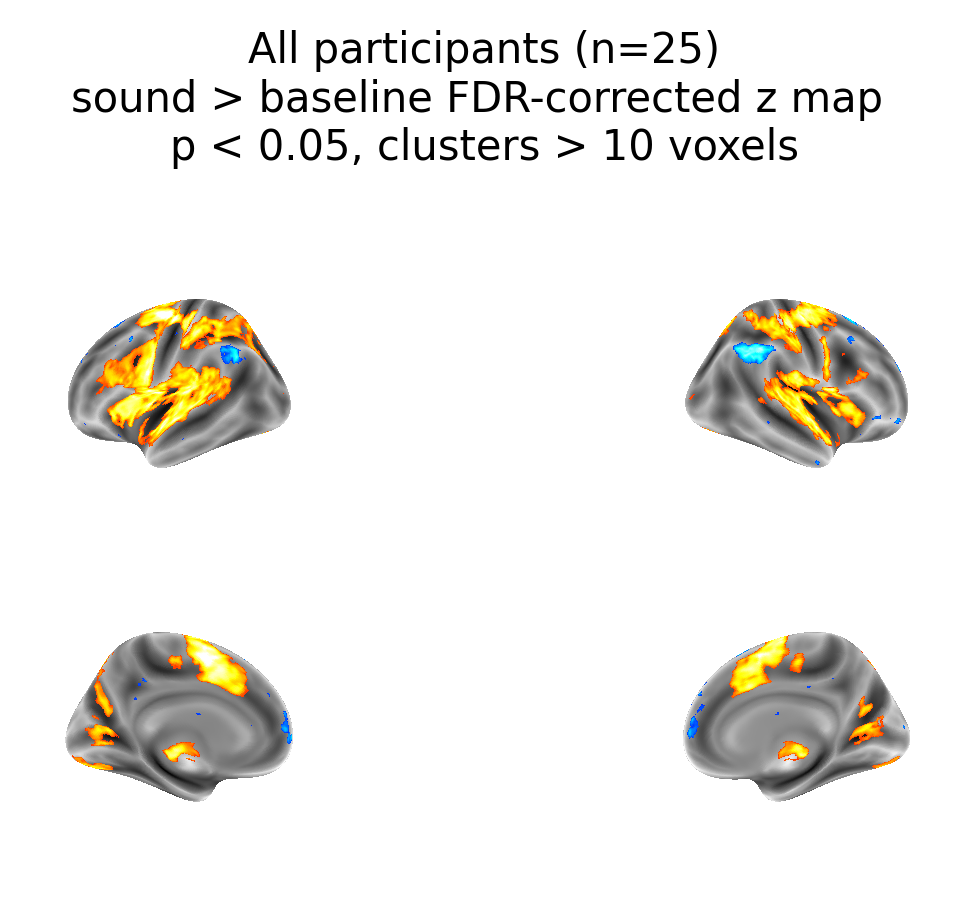

In [47]:
fig2, axes2 = plt.subplots(nrows=2, ncols=2, subplot_kw={"projection": "3d"}, figsize=(5,3), dpi=300)
fig2.suptitle(plot_title, fontsize=10)

texture_left = surface.vol_to_surf(thresholded_map, fsaverage.pial_left)
texture_right = surface.vol_to_surf(thresholded_map, fsaverage.pial_right)

# left hemisphere lateral view
plotting.plot_surf_stat_map(fsaverage.infl_left, texture_left, hemi='left',
                            #title='{} group – {} contrast'.format(group, contrast),
                            vmax=6,
                            colorbar=False,
                            threshold=zthresh, 
                            view='lateral',
                            bg_map=fsaverage.sulc_left, 
                            axes=axes2[0,0], 
                            fig=fig2
                            )

# right hemisphere lateral view
plotting.plot_surf_stat_map(fsaverage.infl_right, texture_right, hemi='right',
                            #title='{} group – {} contrast'.format(group, contrast),
                            #colorbar=True,
                            vmax=6,
                            colorbar=False,
                            threshold=zthresh, 
                            view='lateral',
                            bg_map=fsaverage.sulc_right, 
                            axes=axes2[0,1], 
                            fig=fig2
                            )

# left hemisphere medial view
plotting.plot_surf_stat_map(fsaverage.infl_left, texture_left, hemi='left',
                            #title='{} group – {} contrast'.format(group, contrast),
                            vmax=6,
                            colorbar=False,
                            threshold=zthresh, 
                            view='medial',
                            bg_map=fsaverage.sulc_left, 
                            axes=axes2[1,0], 
                            fig=fig2
                            )

# right hemisphere medial view
plotting.plot_surf_stat_map(fsaverage.infl_right, texture_right, hemi='right',
                            #title='{} group – {} contrast'.format(group, contrast),
                            #colorbar=True,
                            vmax=6,
                            colorbar=False,
                            threshold=zthresh, 
                            view='medial',
                            bg_map=fsaverage.sulc_right, 
                            axes=axes2[1,1], 
                            fig=fig2
                            )
fig2.tight_layout()
fig2.show()
fig2.savefig(os.path.join(group_out_dir,
                     'group-{}_space-{}_contrast-{}_view-surface.png'.format(group_label, space_label, contrast_label)))

#### High-res subcortical slices

All participants (n=24)
sound > baseline FDR-corrected z map 
p < 0.05, clusters > 10 voxels


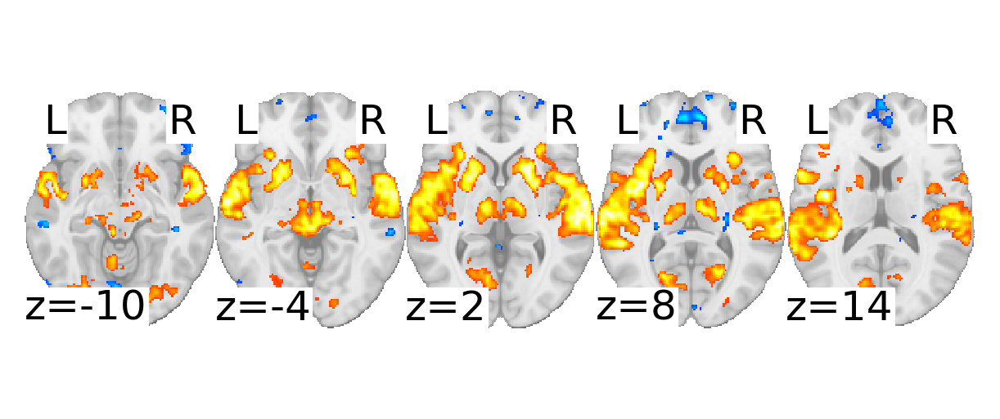

In [47]:
fig1, ax1 = plt.subplots(figsize=(5,2), dpi=300)
print(plot_title)
plotting.plot_stat_map(thresholded_map,
                       bg_img=mni152_template,
                       threshold=zthresh,
                       vmax=6,
                       cut_coords=[-10, -4, 2, 8, 14],
                       display_mode='z',
                       colorbar=False, 
                       draw_cross=False, 
                       black_bg=False,
                       axes=ax1)
fig1.savefig(os.path.join(group_out_dir,
                     'group-{}_space-{}_contrast-{}_view-axial-subcort.png'.format(group_label, space_label, contrast_label)))